<a href="https://colab.research.google.com/github/peterfan727/peterfan727/blob/main/Kaggle.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 0. Download Datasets


In [ ]:
! git clone https://github.com/dinglijay/kaggle.git/
! unzip kaggle/images.zip

# 1. Check data balance, looks great

In [ ]:
import glob
import numpy as np

file_list = glob.glob('./images/*.jpg')
labels = np.array([1 if f.split("/")[-1][0] == 'P' else 0 for f in file_list])
print(f'Total: {len(labels)}, Class 0: {sum(labels==0)}, Class 1: {sum(labels==1)}')

Total: 714, Class 0: 345, Class 1: 369


# 2. Build Dataset

In [ ]:
import cv2
import glob, os
import torch

from torch.utils.data import Dataset, DataLoader

def read_image(f_path, permute=True):
    img = cv2.imread(f_path) 
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = img.astype(np.float32) / 255.0
    if permute:
        img = np.transpose(img, (2,0,1))
    return img

class BeeDataset(Dataset):
    def __init__(self):
        path = './images'
        imlist= glob.glob(os.path.join(path, '*.jpg'))
        self.imgs = np.array([read_image(im_name) for im_name in imlist])
        self.labels = np.array([1 if f.split("/")[-1][0] == 'P' else 0 for f in imlist])

    def __len__(self):
        return self.labels.shape[0]

    def __getitem__(self, idx):
        img = self.imgs[idx]
        label = self.labels[idx]

        return img, label


# 3. Build Transforms for Data Augmentation

In [ ]:
import torch

from torchvision import transforms
from torchvision.utils import make_grid, save_image

transformer = torch.nn.Sequential(
    transforms.Resize((224, 224)),
    transforms.RandomAffine(degrees=[-10, 10],
                            translate=(0.1, 0.1),
                            scale=[0.8, 1.1],
                            shear=[-5, 5],
                            fill=0.5),
    transforms.ColorJitter(brightness=0.2,
                           contrast=0.2,
                           saturation=0,
                           hue=0.01),
    transforms.RandomHorizontalFlip(p=0.5),
)

resizer = transforms.Resize((224, 224))

# 4. Check Data Augmentation Results and Tune Aug. Parameters

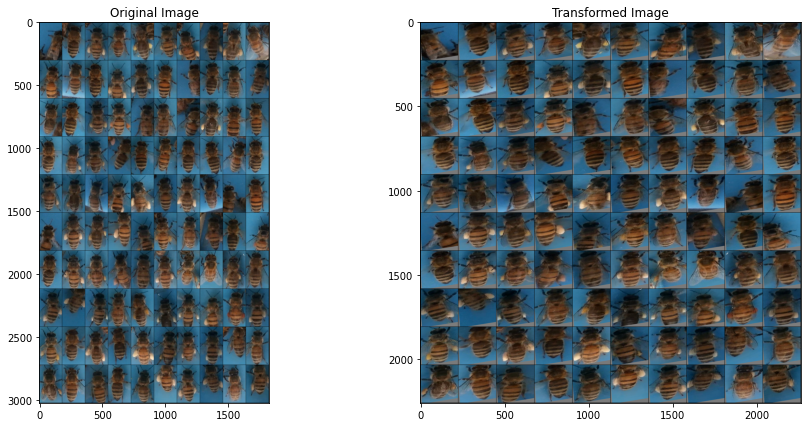

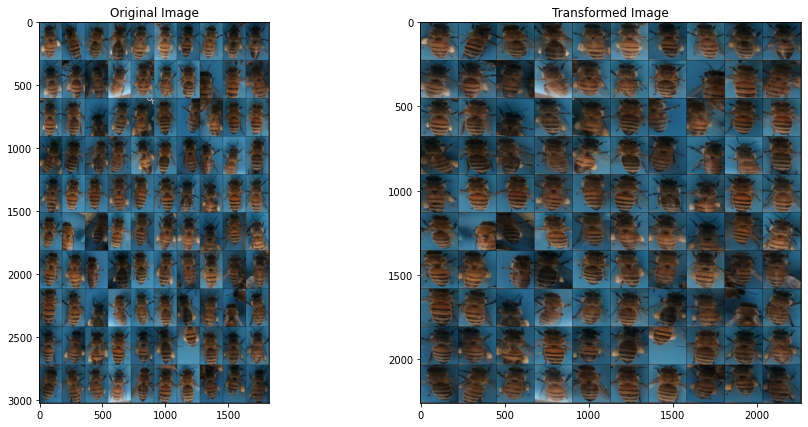

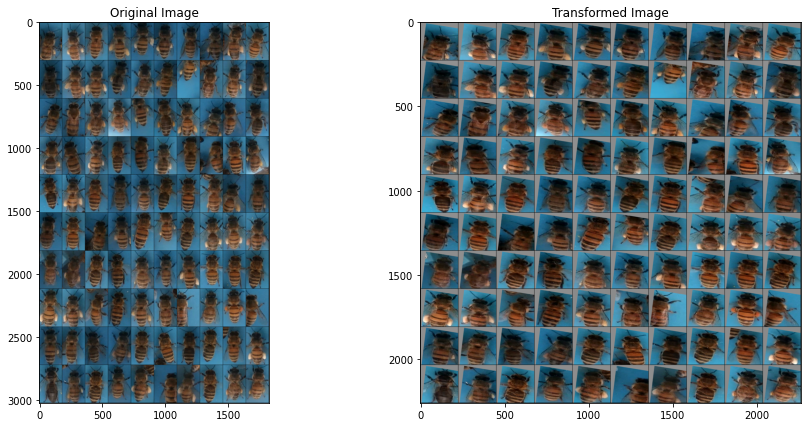

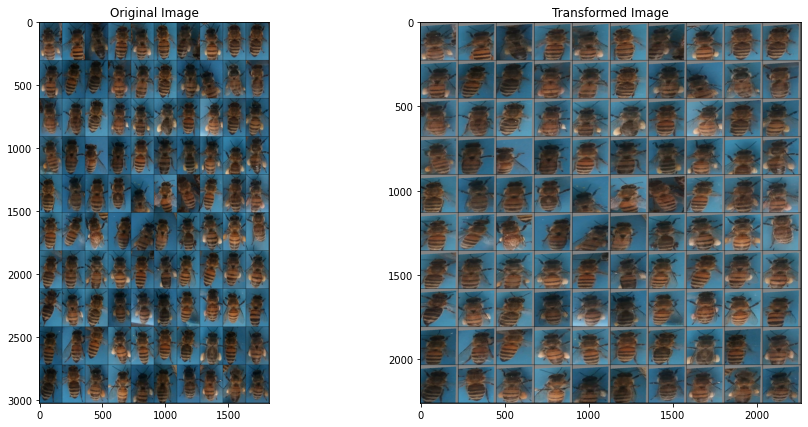

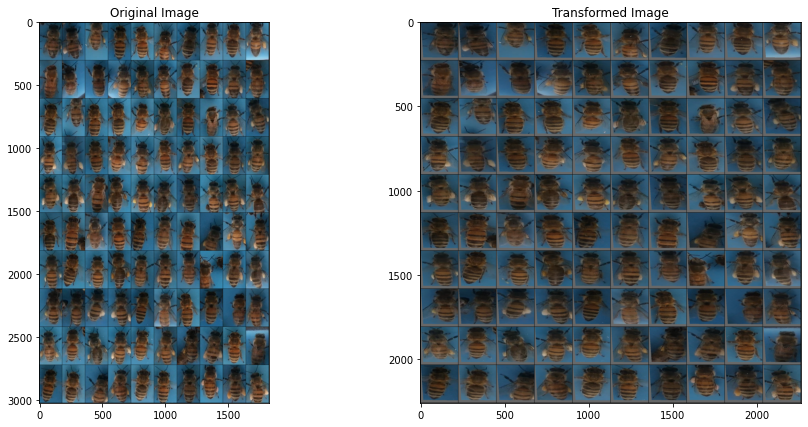

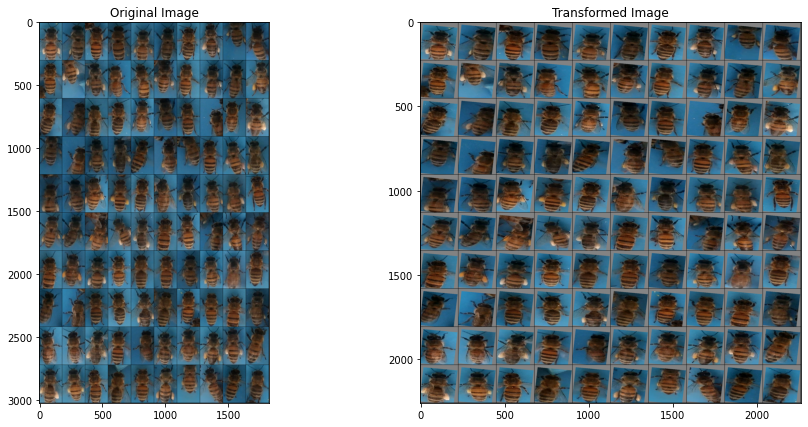

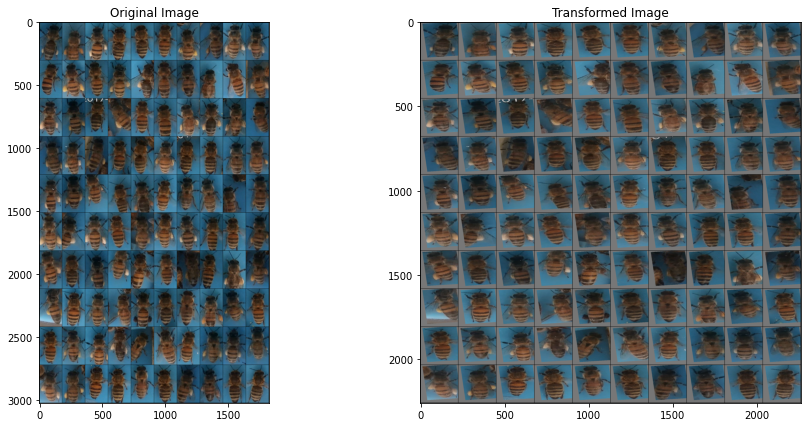

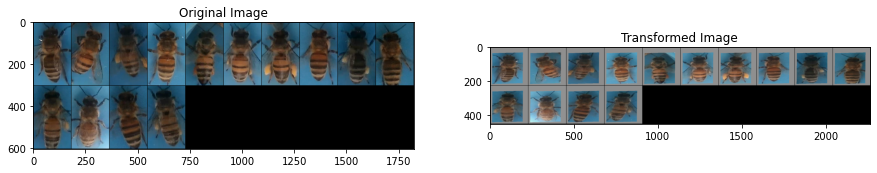

In [ ]:
from matplotlib import pyplot as plt
from torchvision.utils import make_grid, save_image

def tensor_to_img(tensor):
    return tensor.squeeze().permute(1,2,0).cpu().numpy()

dataloader = DataLoader(BeeDataset(), batch_size=100, shuffle=False)
for imgs_slice, labels_slice in dataloader:
    fig, axes = plt.subplots(1, 2, figsize=(15, 7))
    axes[0].imshow(tensor_to_img(make_grid(imgs_slice, 10)))
    axes[0].title.set_text('Original Image')
    axes[1].imshow(tensor_to_img(make_grid(transformer(imgs_slice), 10)))
    axes[1].title.set_text('Transformed Image')


# 5. Build CNN Model

In [ ]:
from torch import nn

device = "cuda" if torch.cuda.is_available() else "cpu"
print("Using {} device".format(device))

class NeuralNetwork(nn.Module):
    def __init__(self):
        super(NeuralNetwork, self).__init__()

        self.features = nn.Sequential(
            nn.Conv2d(3, 32, kernel_size=3, stride=2, padding=1),  
            nn.LeakyReLU(negative_slope=0.2),
            nn.MaxPool2d(kernel_size=2, stride=2),  
            nn.Conv2d(32, 32, kernel_size=3, stride=2, padding=1),  
            nn.LeakyReLU(negative_slope=0.2),
            nn.MaxPool2d(kernel_size=2, stride=2),
        )

        self.classifier = nn.Sequential(
            nn.Dropout(0.5),
            nn.Linear(32 * 14 * 14, 128),
            nn.LeakyReLU(negative_slope=0.2),
            nn.Dropout(0.5),
            nn.Linear(128, 2),
        )

    def forward(self, x):
        x = self.features(x)
        x = x.reshape(x.shape[0], -1)
        logits = self.classifier(x)
        return logits

model = NeuralNetwork().to(device)
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=5e-4)

print(f'Number of Parameters: {sum(p.numel() for p in model.parameters())}')
print(model)

Using cuda device
Number of Parameters: 813346
NeuralNetwork(
  (features): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2)
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(32, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (4): LeakyReLU(negative_slope=0.2)
    (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (classifier): Sequential(
    (0): Dropout(p=0.5, inplace=False)
    (1): Linear(in_features=6272, out_features=128, bias=True)
    (2): LeakyReLU(negative_slope=0.2)
    (3): Dropout(p=0.5, inplace=False)
    (4): Linear(in_features=128, out_features=2, bias=True)
  )
)


# 6. Batch training and testing

In [ ]:
def train(dataloader, model, loss_fn, optimizer):
    size = len(dataloader.dataset)
    for batch, (X, y) in enumerate(dataloader):
        X, y = X.to(device), y.to(device)
        X = transformer(X)

        pred = model(X)
        loss = loss_fn(pred, y)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        global cnt
        cnt += 1
        writer.add_scalar('training loss', loss/1000, cnt)
        # print(f"Training Loss: {loss/1000:>0.4f}")

def test(dataloader, model):
    size = len(dataloader.dataset)
    model.eval()
    test_loss, correct = 0, 0
    with torch.no_grad():
        for X, y in dataloader:
            X, y = X.to(device), y.to(device)
            X = resizer(X)
            pred = model(X)
            test_loss += loss_fn(pred, y).item()
            correct += (pred.argmax(1) == y).type(torch.float).sum().item()
    test_loss /= size
    correct /= size
    writer.add_scalar('test loss', test_loss/1000, cnt)
    writer.add_scalar('test Accuracy', correct, cnt)
    print(f"Test Accuracy: {(100*correct):>0.1f}%")

# 7. Training

In [ ]:
from torch.utils.tensorboard import SummaryWriter

SPLIT_RATE = 0.7
N_EPOCH = 100
BATCH_SIZE = 32

# Split training and test set
dataset = BeeDataset()
train_size = int(len(dataset)*SPLIT_RATE)
test_size = len(dataset) - train_size
dataset_train, dataset_test = torch.utils.data.random_split(dataset, [train_size, test_size])
dataloader_train = DataLoader(dataset_train, batch_size=BATCH_SIZE, shuffle=True)
dataloader_test = DataLoader(dataset_test, batch_size=200, shuffle=False)

# reset model if needed
def weight_reset(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.Linear):
        m.reset_parameters()
model.apply(weight_reset)

! rm -r ./runs
writer = SummaryWriter('runs/')

cnt = 0
for n_epoch in range(N_EPOCH):
    print(f"Epoch {n_epoch+1}\n---------------------")
    train(dataloader_train, model, loss_fn, optimizer)
    test(dataloader_test, model)

print("Done!")

# 8. Reporting Result

Classification Report:
----------------------
               precision    recall  f1-score   support

   No Pollen       0.91      0.96      0.94       105
      Pollen       0.96      0.91      0.93       110

    accuracy                           0.93       215
   macro avg       0.94      0.94      0.93       215
weighted avg       0.94      0.93      0.93       215



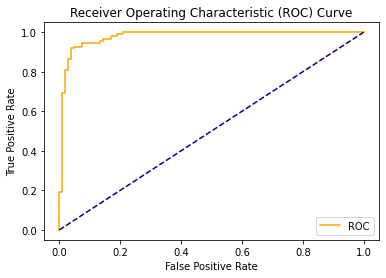

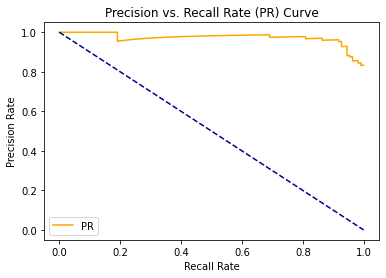

In [ ]:
# Evaluation Result
from sklearn import metrics

model.eval()
test_loss, correct = 0, 0
preds, ys = [], []
with torch.no_grad():
    for X, y in dataloader_test:
        X, y = X.to(device), y.to(device)
        X = resizer(X)
        pred = model(X)
        preds.append(pred)
        ys.append(y)
preds_p = torch.softmax(torch.vstack(preds), dim=1)[:,1].cpu().numpy()
preds = torch.argmax(torch.vstack(preds), dim=1).cpu().numpy()
ys = torch.hstack(ys).cpu().numpy()

clr = metrics.classification_report(ys, preds, labels=[0, 1], target_names=["No Pollen", "Pollen"])
print("Classification Report:\n----------------------\n", clr)
        
def plot_roc_curve(fpr, tpr):
    plt.figure()
    plt.plot(fpr, tpr, color='orange', label='ROC')
    plt.plot([0, 1], [0, 1], color='darkblue', linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend()

def plot_pr_curve(recall, precision):
    plt.figure()

    plt.plot(recall, precision, color='orange', label='PR')
    plt.plot([0, 1], [1, 0], color='darkblue', linestyle='--')
    plt.xlabel('Recall Rate')
    plt.ylabel('Precision Rate')
    plt.title('Precision vs. Recall Rate (PR) Curve')
    plt.legend()

fpr, tpr, thresholds = metrics.roc_curve(ys, preds_p)
plot_roc_curve(fpr, tpr)

precision, recall, thresholds = metrics.precision_recall_curve(ys, preds_p)
plot_pr_curve(recall, precision)


# 9. Monitor Training on Tensorboard

In [ ]:
%load_ext tensorboard
%tensorboard --logdir=runs

<IPython.core.display.Javascript object>